# Abstract Image Generation Using Deep Convolutional Generative Adversarial Networks

# What is Generative Model?
## Generative model is a class of models for Unsupervised learning where given training data our goal is to try and generate new samples from the same distribution.

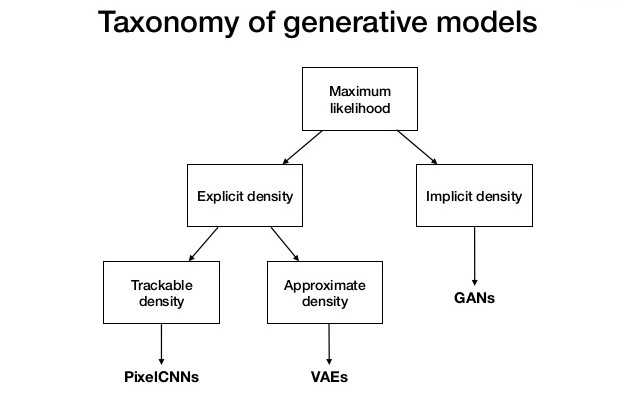

In [8]:
Image(filename='TGAN.jpg')

# The main advantage of GANs over Autoencoders in generating data is that they can be conditioned by different inputs. Autoencoders are more suitable for compressing data to lower dimensions or generating semantic vectors from it. Where GANs are more suitable for generating data.

# Architecture of Deep Convolutional Generative Adversarial Networks

## The GAN is made up of two different neural networks: the discriminator and the generator. The generator generates the images, while the discriminator detects if a face is real or was generated.

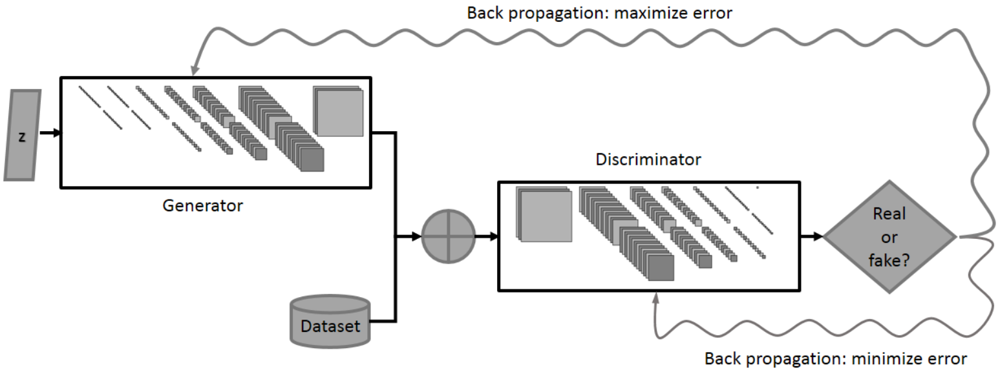

In [9]:
Image(filename='GANA.png')

# The Deep Convolutional GAN is the improvement of the GAN, they are more stable and generates higher quality images. In DCGAN batch normalization is must in both the generator & discriminator networks. Adversarial pair learns a hierarchy of representations from object parts to scenes in both the generator and discriminator.

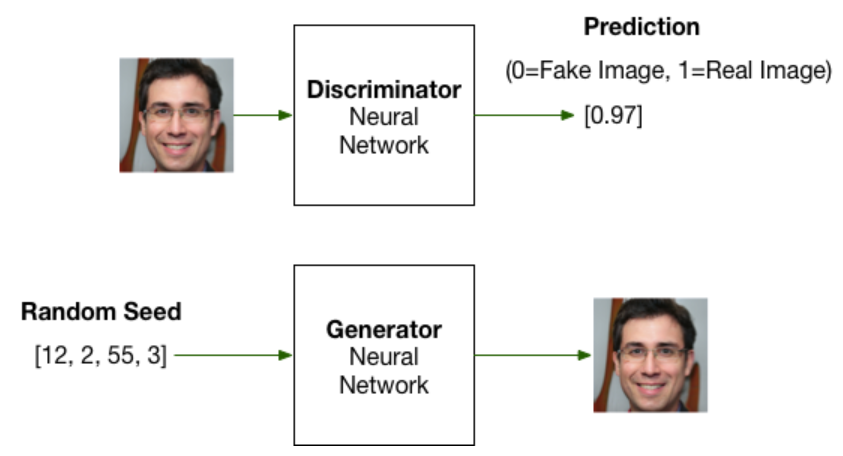

In [15]:
Image(filename='GAN.png')

# The discriminator accepts an image as its input and produces number that is the probability of the input image being real. The generator accepts a random seed vector and generates an image from that random vector seed. An unlimited number of new images can be created by providing additional seeds.

# Different Use Cases of Generative Adversarial Networks

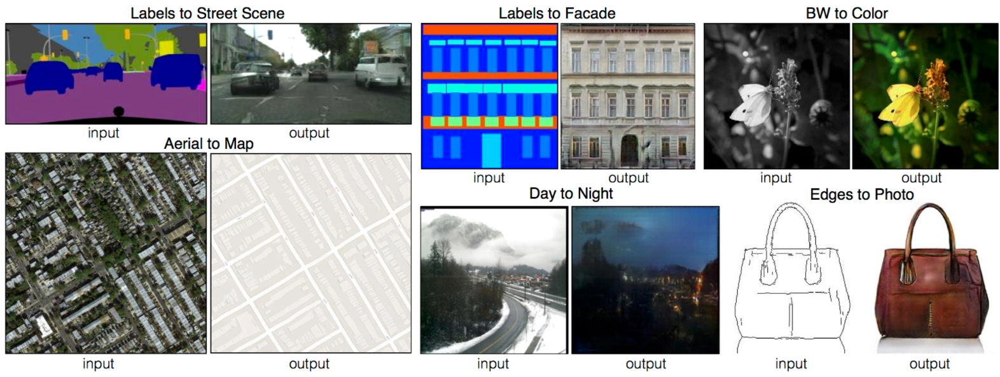

In [11]:
Image(filename='GANU.png')

# Datasets Used In This Research

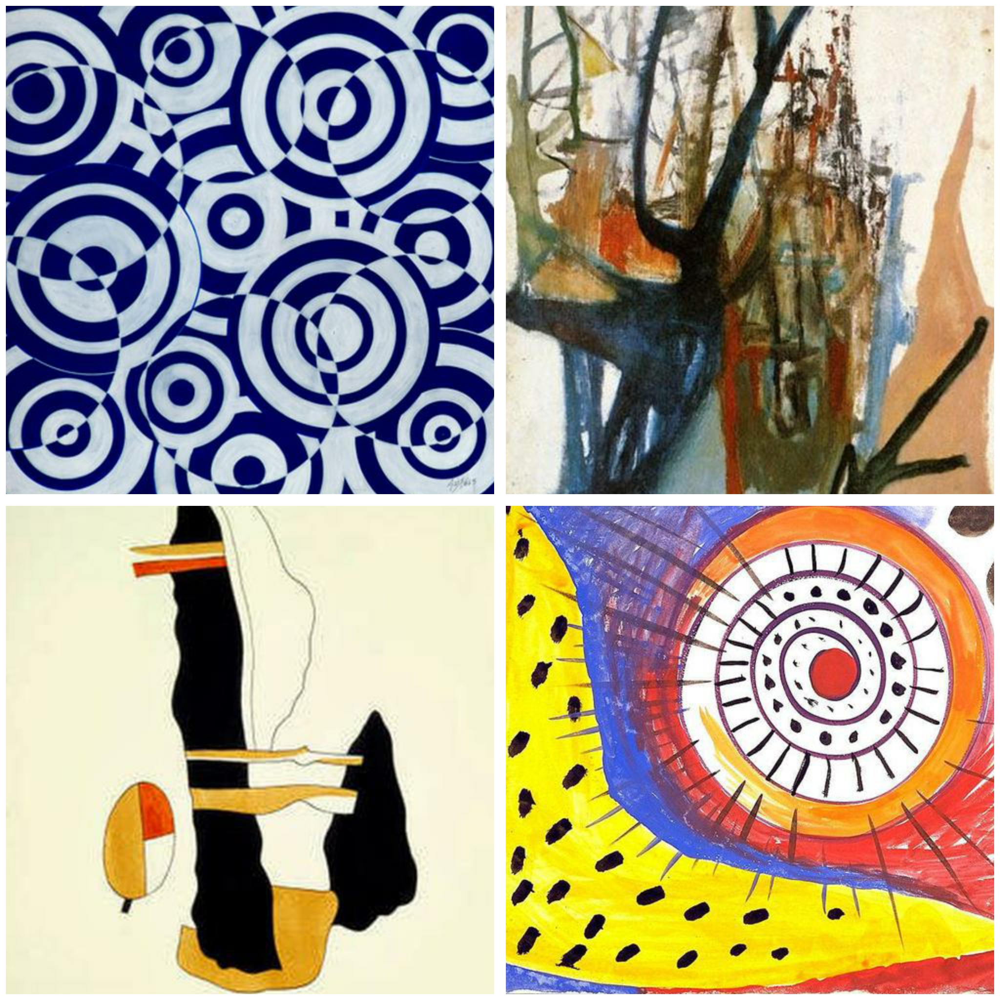

In [13]:
Image(filename='D_1.jpg') 
Image(filename='D_2.jpg')

# Creating Time String Format for Printing durations for each Epoch 

In [ ]:
# Nicely formatted time string
def hms_string(sec_elapsed):
    h = int(sec_elapsed / (60 * 60))
    m = int((sec_elapsed % (60 * 60)) / 60)
    s = sec_elapsed % 60
    return "{}:{:>02}:{:>05.2f}".format(h, m, s)

# Importing the required Packages

In [2]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Reshape, Dropout, Dense 
from tensorflow.keras.layers import Flatten, BatchNormalization
from tensorflow.keras.layers import Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
import numpy as np
from PIL import Image
from tqdm import tqdm
import os 
import time
import matplotlib.pyplot as plt
from IPython.display import Image

In [3]:
os.getcwd()

'C:\\Users\\yashi\\Desktop\\IG_SR'

# These are the constants that define how the GANs will be created, the higher the resolution, the more memory that will be needed. Higher resolution will also result in longer run times.
# The resolution is specified as a multiple of 32. So GENERATE_RES of 1 is 32, 2 is 64, etc. The constant DATA_PATH defines where these images are stored.

In [4]:
# Generation resolution - Must be square 
# Training data is also scaled to this.
# Note GENERATE_RES 4 or higher  
# will blow Google CoLab's memory and have not
# been tested extensivly.
GENERATE_RES = 3 # Generation resolution factor 
# (1=32, 2=64, 3=96, 4=128, etc.)
GENERATE_SQUARE = 32 * GENERATE_RES # rows/cols (should be square)
IMAGE_CHANNELS = 3

# Preview image 
PREVIEW_ROWS = 4
PREVIEW_COLS = 7
PREVIEW_MARGIN = 16

# Size vector to generate images from
SEED_SIZE = 100

# Configuration
DATA_PATH = 'C:\\Users\\yashi\\Desktop\\IG_SR'
EPOCHS = 50
BATCH_SIZE = 32
BUFFER_SIZE = 60000

print(f"Will generate {GENERATE_SQUARE}px square images.")

Will generate 96px square images.


# Next we will load and preprocess the images. This can take awhile. Because of this we store the processed file as a binary. This way we can simply reload the processed training data and quickly use it. It is most efficient to only perform this operation once. The dimensions of the image are encoded into the filename of the binary file because we need to regenerate it if these change.

In [5]:
# Image set has 11,682 images.  Can take over an hour 
# for initial preprocessing.
# Because of this time needed, save a Numpy preprocessed file.
# Note, that file is large enough to cause problems for 
# sume verisons of Pickle,
# so Numpy binary files are used.
training_binary_path = os.path.join(DATA_PATH,
        f'training_data_{GENERATE_SQUARE}.npy')

print(f"Looking for file: {training_binary_path}")

if not os.path.isfile(training_binary_path):
  start = time.time()
  print("Loading training images...")

  training_data = []
  faces_path = os.path.join(DATA_PATH,'images')
  for filename in tqdm(os.listdir(faces_path)):
      path = os.path.join(faces_path,filename)
      image = Image.open(path).resize((GENERATE_SQUARE,
            GENERATE_SQUARE),Image.ANTIALIAS)
      training_data.append(np.asarray(image))
  training_data = np.reshape(training_data,(-1,GENERATE_SQUARE,
            GENERATE_SQUARE,IMAGE_CHANNELS))
  training_data = training_data.astype(np.float32)
  training_data = training_data / 127.5 - 1.


  print("Saving training image binary...")
  np.save(training_binary_path,training_data)
  elapsed = time.time()-start
  print (f'Image preprocess time: {hms_string(elapsed)}')
else:
  print("Loading previous training pickle...")
  training_data = np.load(training_binary_path)

Looking for file: C:\Users\yashi\Desktop\IG_SR\training_data_96.npy
Loading previous training pickle...


# We will use a TensorFlow Dataset object to actually hold the images. This allows the data to be quickly shuffled int divided into the appropriate batch sizes for training.

In [6]:
# Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(training_data) \
    .shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# The code below creates the generator and discriminator.

# Next we actually build the discriminator and the generator. Both will be trained with the Adam optimizer.

In [9]:
def build_generator(seed_size, channels):
    model = Sequential()

    model.add(Dense(4*4*256,activation="relu",input_dim=seed_size))
    model.add(Reshape((4,4,256)))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))
   
    # Output resolution, additional upsampling
    model.add(UpSampling2D())
    model.add(Conv2D(128,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    if GENERATE_RES>1:
      model.add(UpSampling2D(size=(GENERATE_RES,GENERATE_RES)))
      model.add(Conv2D(128,kernel_size=3,padding="same"))
      model.add(BatchNormalization(momentum=0.8))
      model.add(Activation("relu"))

    # Final CNN layer
    model.add(Conv2D(channels,kernel_size=3,padding="same"))
    model.add(Activation("tanh"))

    return model


def build_discriminator(image_shape):
    model = Sequential()

    model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=image_shape, 
                     padding="same"))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
    model.add(ZeroPadding2D(padding=((0,1),(0,1))))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model

# As we progress through training images will be produced to show the progress. These images will contain a number of rendered faces that show how good the generator has become. 

In [10]:
def save_images(cnt,noise):
  image_array = np.full(( 
      PREVIEW_MARGIN + (PREVIEW_ROWS * (GENERATE_SQUARE+PREVIEW_MARGIN)), 
      PREVIEW_MARGIN + (PREVIEW_COLS * (GENERATE_SQUARE+PREVIEW_MARGIN)), 3), 
      255, dtype=np.uint8)
  
  generated_images = generator.predict(noise)

  generated_images = 0.5 * generated_images + 0.5

  image_count = 0
  for row in range(PREVIEW_ROWS):
      for col in range(PREVIEW_COLS):
        r = row * (GENERATE_SQUARE+16) + PREVIEW_MARGIN
        c = col * (GENERATE_SQUARE+16) + PREVIEW_MARGIN
        image_array[r:r+GENERATE_SQUARE,c:c+GENERATE_SQUARE] \
            = generated_images[image_count] * 255
        image_count += 1

          
  output_path = os.path.join(DATA_PATH,'output_ig')
  if not os.path.exists(output_path):
    os.makedirs(output_path)
  
  filename = os.path.join(output_path,f"train-{cnt}.png")
  im = Image.fromarray(image_array)
  im.save(filename)

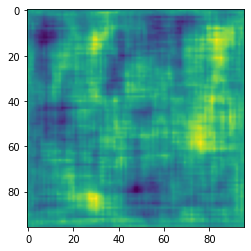

In [11]:
generator = build_generator(SEED_SIZE, IMAGE_CHANNELS)

noise = tf.random.normal([1, SEED_SIZE])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0])

In [12]:
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 4096)              413696    
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 256)         0         
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d (Conv2D)              (None, 8, 8, 256)         590080    
_________________________________________________________________
batch_normalization (BatchNo (None, 8, 8, 256)         1024      
_________________________________________________________________
activation (Activation)      (None, 8, 8, 256)         0         
_________________________________________________________________
up_sampling2d_1 (UpSampling2 (None, 16, 16, 256)       0

In [13]:
image_shape = (GENERATE_SQUARE,GENERATE_SQUARE,IMAGE_CHANNELS)

discriminator = build_discriminator(image_shape)
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.49923584]], shape=(1, 1), dtype=float32)


In [14]:
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 48, 48, 32)        896       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 48, 48, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 48, 48, 32)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 24, 24, 64)        18496     
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 25, 25, 64)        0         
_________________________________________________________________
batch_normalization_4 (Batch (None, 25, 25, 64)        256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 25, 25, 64)       

# Loss functions must be developed that allow the generator and discriminator to be trained in an adversarial way. Because these two neural networks are being trained independently they must be trained in two separate passes. This requires two separate loss functions and also two separate updates to the gradients. When the discriminator's gradients are applied to decrease the discriminator's loss it is important that only the discriminator's weights are update. It is not fair, nor will it produce good results, to adversarially damage the weights of the generator to help the discriminator. A simple backpropagation would do this. It would simultaneously affect the weights of both generator and discriminator to lower whatever loss it was assigned to lower.

In [15]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy()

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Both the generator and discriminator use Adam and the same learning rate and momentum. This does not need to be the case. If you use a GENERATE_RES greater than 3 you may need to tune these learning rates, as well as other training and hyperparameters.

In [16]:
generator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)

# The following function is where most of the training takes place for both the discriminator and the generator. This function was based on the GAN provided by the TensorFlow Keras exmples documentation.
# It is an Annotated with the tf.function Annotation, this causes the function to be precompiled and improves performance.
# This code makes use of GradientTape to allow the discriminator and generator to be trained together, yet separately.

In [17]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
  seed = tf.random.normal([BATCH_SIZE, SEED_SIZE])

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(seed, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)
    

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
  return gen_loss,disc_loss

In [18]:
def train(dataset, epochs):
  fixed_seed = np.random.normal(0, 1, (PREVIEW_ROWS * PREVIEW_COLS, 
                                       SEED_SIZE))
  start = time.time()

  for epoch in range(epochs):
    epoch_start = time.time()

    gen_loss_list = []
    disc_loss_list = []

    for image_batch in dataset:
      t = train_step(image_batch)
      gen_loss_list.append(t[0])
      disc_loss_list.append(t[1])

    g_loss = sum(gen_loss_list) / len(gen_loss_list)
    d_loss = sum(disc_loss_list) / len(disc_loss_list)
    
    epoch_elapsed = time.time()- epoch_start
    print (f'Epoch {epoch+1}, gen loss={g_loss},disc loss={d_loss}')
    print(hms_string(epoch_elapsed))
    save_images(epoch,fixed_seed)

  elapsed = time.time()-start
  print (f'Training time = {hms_string(elapsed)}')

In [19]:
train(train_dataset, EPOCHS)

Epoch 1, gen loss=1.2993900775909424,disc loss=1.5689876079559326
0:00:18.81
Epoch 2, gen loss=2.30267333984375,disc loss=1.597964882850647
0:00:09.11
Epoch 3, gen loss=2.8880791664123535,disc loss=0.8300623893737793
0:00:09.12
Epoch 4, gen loss=4.131961822509766,disc loss=0.6773067116737366
0:00:09.16
Epoch 5, gen loss=4.205615043640137,disc loss=1.169342279434204
0:00:09.12
Epoch 6, gen loss=5.39519739151001,disc loss=0.6410356163978577
0:00:09.11
Epoch 7, gen loss=3.70338773727417,disc loss=1.563893437385559
0:00:09.13
Epoch 8, gen loss=3.7298030853271484,disc loss=1.059114933013916
0:00:09.15
Epoch 9, gen loss=3.7171502113342285,disc loss=1.070054292678833
0:00:09.15
Epoch 10, gen loss=3.6518301963806152,disc loss=0.8360611796379089
0:00:09.14
Epoch 11, gen loss=3.8095526695251465,disc loss=1.4588478803634644
0:00:09.14
Epoch 12, gen loss=2.987220287322998,disc loss=1.729367733001709
0:00:09.14
Epoch 13, gen loss=2.1854231357574463,disc loss=1.7673059701919556
0:00:09.15
Epoch 14, 

In [20]:
generator.save(os.path.join(DATA_PATH,"face_generator.h5"))

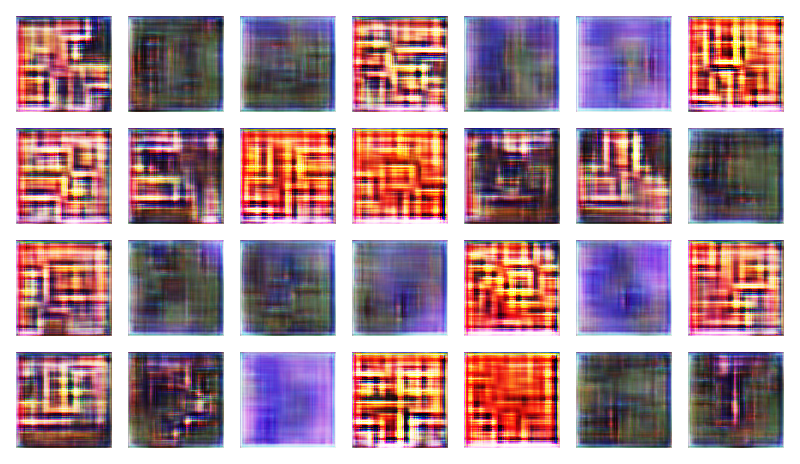

In [32]:
# PIL is a library which may open different image file formats
import PIL 
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('train-{:d}.png'.format(epoch_no))
display_image(49)

In [59]:
import imageio
import os

def assemble_animated_gif(dir_path, filenames, filename_out):
    filepath_out = os.path.join(dir_path, filename_out)
    images = []
    for filename in filenames:
        temp = os.path.join(dir_path, filename)
        image = imageio.imread(temp)
        images.append(image)
    imageio.mimsave(filepath_out, images, format='GIF', duration=1)

def assemble_filenames(name, number):
    filenames = []
    for i in range(0, number, 1):
        s = "{}{}.png".format(name, i)
        filenames.append(s)
    return filenames

def main():
    DATA_PATH = 'C:\\Users\\yashi\\Desktop\\IG_SR'
    dir_path = os.path.join(DATA_PATH, "output_ig")   
    filenames = assemble_filenames("train-", 49)
    assemble_animated_gif(dir_path, filenames, "gif02.gif")

if __name__ == "__main__":
    main()

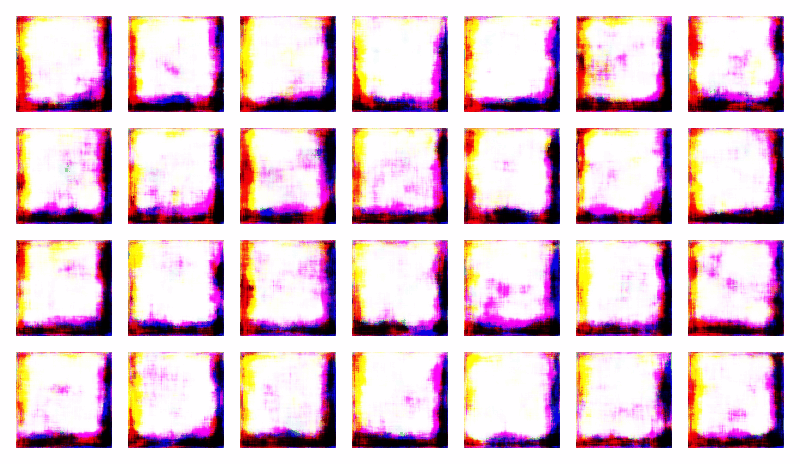

In [5]:
from IPython.display import Image
Image(filename="gif02.gif")

In [ ]:
plt.plot(gen_loss_list)
plt.show()

In [ ]:
plt.plot(disc_loss_list)
plt.show()